In [2]:
import os
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils

import wave
import scipy.signal as sg
from pathlib import Path

import warnings
warnings.filterwarnings("ignore")
plt.ion()

In [3]:
def calc_array_manifold_vector(theta, n_mic, n_bin, fs, N, c):
    # ysinΘ + xcosΘ
    """
    a: i x n_mic x 1 x n_bin
       方向数 x マイク数 x 1 x 周波数ビン数
    """
    rc = 0.0365
    mic_angle = np.array(
        [
            0,
            -np.pi / 4,
            -np.pi / 2,
            -np.pi * 3 / 4,
            np.pi,
            np.pi * 3 / 4,
            np.pi * 1 / 2,
            np.pi * 1 / 4,
        ]
    )
    a = np.zeros((theta.shape[0], n_mic, 1, n_bin), dtype=np.complex64)
    for i, th in enumerate(theta):
        th = np.radians(th)
        for k in range(n_bin):
            fk = fs * k / N
            for m in range(n_mic):
                delay = -rc * np.cos(th - mic_angle[m]) / c
                a[i, m, 0, k] = np.exp(-1j * 2 * np.pi * fk * delay)
    return a

def load_onefile(file_name):
    """
    return M x frames ndarray
    """
    wav = wave.open(file_name)
    # print("sample width:", wav.getsampwidth())
    # print("channel num:", wav.getnchannels())
    # print("frames:", wav.getnframes())

    M = wav.getnchannels()

    data = wav.readframes(wav.getnframes())
    data = np.frombuffer(data, dtype=np.int16)
    data = data / np.iinfo(np.int16).max

    multi_data = data.reshape(-1, M)
    multi_data = np.transpose(multi_data)
    # print("multi_data.shape:", multi_data.shape)

    wav.close()

    return multi_data

def MUSIC_indexbase(file_name, t_left_sec, t_right_sec, interval,  start_angle, end_angle, N, noverlap=None, weighting=True):
  """
  N: nperseg，窓関数の適用間隔
      noverlapは指定されなかった場合，デフォルトでnpersegの1/2になる
  """
  
  
  n_mic = 8
  n_src = 3
  window = "hann"
  c = 340
  freq_l = 100
  freq_h = 4000

  fs = 16000
  k_l = int(freq_l / (fs / N))
  k_h = int(freq_h / (fs / N))

  audio = load_onefile(file_name)

  # print(audio.shape)」
  if noverlap == None:
    noverlap = N / 2 
  
  # X: マイク数 x 周波数インデックス x 時間インデックス
  f, t, X = sg.stft(audio, fs, window=window, nperseg=N, noverlap=noverlap)
  n_bin = X.shape[1]
  
  t_left_index = (int)(t_left_sec // ((N - noverlap)/fs))
  t_right_index = (int)((t_right_sec + ((N - noverlap) / fs)) // ((N - noverlap) / fs))
  print(f"t_left_index: {t_left_index}")
  print(f"t_right_index: {t_right_index}")
  
  theta = np.linspace(
      start_angle, end_angle, num=((end_angle - start_angle) // 5) + 1
  )
  P_MU_LIST = None
  TIME_RANGE_LIST = None
  
  a = calc_array_manifold_vector(theta, n_mic, n_bin, fs, N, c)
  
  # t_left_index から interval　分だけインデックスをずらす t_right_index に到達するまで
  # ループ
  # やること：とりあえずtrim処理以下をまんまループに入れて実行
  # 書きかけて気づいたけど，特定範囲でのMUSICスペクトルを適宜出してほしい
  # ↑いやそんなことはない
  # 　まとめて処理して時間インデックスを持ってればいい
  #対応する時間範囲もreturnすればいいかも
  while t_left_index+interval < t_right_index:
    P_MU = np.zeros((theta.shape[0], f.shape[0]))
    # print(X.shape)
    X_trimed = X[:, :, t_left_index:(t_left_index+interval)]
    time_range = np.array([[t[t_left_index], t[t_left_index+interval]]])
    XH = np.conjugate(X_trimed)
    XXH = np.einsum("mki,nki->mnki", X_trimed, XH)
    R = np.mean(XXH, axis=3) # ここで時間平均を取っている(時間範囲での期待値に相当)

    eig_val = np.zeros((n_mic, n_bin), dtype=np.complex64)
    eig_vec = np.zeros((n_mic, n_mic, n_bin), dtype=np.complex64)
    beta = np.zeros(n_bin)
    for k in range(n_bin):
        eig_val_k, eig_vec_k = np.linalg.eig(
            R[:, :, k]
        )  # 周波数ごとに固有値、固有ベクトルを算出
        sort = np.argsort(-1.0 * np.abs(eig_val_k))
        eig_val[:, k] = eig_val_k[sort]
        eig_vec[:, :, k] = eig_vec_k[:, sort]

    W = eig_vec[:, n_src:, :]
    beta = np.sum(np.abs(eig_val[:n_src, :]), axis=0) # 固有値は各周波数のパワーなので，それを用いた重み付けのための項 参考：https://nettyukobo.com/music/

    for i, th in enumerate(theta):
        aH = np.conjugate(a[i])
        aHa = np.einsum("mik,mjk->ijk", aH, a[i])
        P_MU_th = np.einsum("mik,mek->iek", aH, W)
        P_MU_th = np.einsum("iek,jek->ijk", P_MU_th, np.conjugate(P_MU_th))
        P_MU_th = np.abs(aHa) / np.abs(P_MU_th)# ?
        # if weighting is True:
        #   P_MU[i] = np.mean(beta[k_l : k_h + 1] * P_MU_th[0, 0, k_l : k_h + 1]) # 重み付けの計算，要素ごとの積をした後meanで1つの値に
        # elif weighting is False:
        #   P_MU[i] = np.mean(P_MU_th[0, 0, :])
        P_MU[i] = P_MU_th[0, 0, :]
    
    if P_MU_LIST is None:
      P_MU_LIST = P_MU[np.newaxis, :, :]
    else:
      P_MU_LIST = np.concatenate((P_MU_LIST, [P_MU]), axis=0)
    
    if TIME_RANGE_LIST is None:
      TIME_RANGE_LIST = time_range
    else:
      TIME_RANGE_LIST = np.concatenate((TIME_RANGE_LIST, time_range), axis=0)
    
    t_left_index += interval

  # P_MU = 10 * np.log10(P_MU)

  return P_MU_LIST, TIME_RANGE_LIST, beta

def calculate_interval_sec(interval, fs, N, noverlap=None):
  if noverlap == None:
    noverlap = N / 2
  print(f"interval is {((N - noverlap) / fs) * interval} sec.")
  
def display_one_file_indexbase(P_MU_LIST, TIME_RANGE_LIST, DISTANCE_LIST=None, beta=None):
  start_angle = -180
  end_angle = 175
  theta = np.linspace(start_angle, end_angle, num=((end_angle-start_angle) // 5) + 1)
  theta = np.deg2rad(theta)

  P_MU_LIST_mean = np.mean(P_MU_LIST, axis=2)
  
  P_MU_LIST_log = 10 * np.log10(P_MU_LIST_mean)
  
  col_num = 5
  row_num = P_MU_LIST_mean.shape[0] // 5 + 1
  
  plt.figure(figsize=(24, row_num * 5))

  for i in range(P_MU_LIST_mean.shape[0]):

    ax = plt.subplot(
      row_num, col_num, i+1, projection="polar"
    )
    ax.plot(theta, P_MU_LIST_mean[i])
    if DISTANCE_LIST is not None:
      ax.set_title(f"dist: {DISTANCE_LIST[i]}")
    ax.set_theta_zero_location("N")
    ax.set_theta_direction(-1)
    
def binary_search(arr, num):
  left = 0
  right = len(arr) - 1
  while left <= right:
    mid = (left + right) // 2
    if arr[mid] <= num:
      left = mid + 1
    if arr[mid] > num:
      right = mid - 1
  return right

def binary_search_upper_bound(arr, num):
  left = 0
  right = len(arr) - 1
  while left < right:
    mid = (left + right) // 2
    if arr[mid] <= num:
      left = mid + 1
    if arr[mid] > num:
      right = mid
  return left


def calc_mean_point(zero_csv_file_name):

  zero_field_df = pd.read_csv(zero_csv_file_name, usecols=["field.ranges0", "field.ranges1", "field.ranges2", "field.ranges3", "field.ranges4"], dtype={
    "field.ranges0": "float64", 
    "field.ranges1": "float64",
    "field.ranges2": "float64", 
    "field.ranges3": "float64",
    "field.ranges4": "float64"
  })
  zero_field_ndarray = zero_field_df.values
  zero_thre = np.mean(zero_field_ndarray[2])
  return zero_thre

def calc_area_label(csv_file_name, distance_0_csv, left_thre_csv, right_thre_csv, TIME_RANGE_LIST, mode="ltor"):
  # DISTANCEを読み出し
  time_df = pd.read_csv(csv_file_name, usecols=["%time"], dtype={
    "%time":"int64"
  })

  field_df = pd.read_csv(csv_file_name, usecols=["field.ranges0", "field.ranges1", "field.ranges2", "field.ranges3", "field.ranges4"], dtype={
    "field.ranges0": "float64", 
    "field.ranges1": "float64",
    "field.ranges2": "float64", 
    "field.ranges3": "float64",
    "field.ranges4": "float64"
  })

  time_ndarray = time_df.values
  field_ndarray = field_df.values

  fixed_time_col = time_ndarray - time_ndarray[0]
  fixed_time_col = fixed_time_col / (10 ** 9)

  time_and_field = np.concatenate([fixed_time_col, field_ndarray], axis=1)

  zero_point = calc_mean_point(distance_0_csv)
  left_thre_point = calc_mean_point(left_thre_csv)
  right_thre_point = calc_mean_point(right_thre_csv)

  DISTANCE_LIST = np.zeros(TIME_RANGE_LIST.shape[0])
  AREA_LIST = np.zeros(TIME_RANGE_LIST.shape[0], dtype="object")

  if mode == "ltor":
    time_and_field[:, 1:5] = time_and_field[:, 1:5] - zero_point
    left_thre_point = left_thre_point - zero_point
    right_thre_point = right_thre_point - zero_point
  elif mode == "rtol":
    time_and_field[:, 1:5] = -(time_and_field[:, 1:5] - zero_point)
    left_thre_point = -(left_thre_point - zero_point)
    right_thre_point = -(right_thre_point - zero_point)
  
  start_point = time_and_field[0, 3]
  goal_point = time_and_field[-1, 3]

  for i in range(TIME_RANGE_LIST.shape[0]):
    left_lidar_time_index = binary_search(time_and_field[:, 0], TIME_RANGE_LIST[i, 0])
    right_lidar_time_index = binary_search_upper_bound(time_and_field[:, 0], TIME_RANGE_LIST[i, 1])
    distance = np.mean(time_and_field[:, 3][left_lidar_time_index:right_lidar_time_index])
    DISTANCE_LIST[i] = distance
  
  for i in range(DISTANCE_LIST.shape[0]):
    if abs(DISTANCE_LIST[i] - start_point) <= 0.1 or abs(DISTANCE_LIST[i] - goal_point) <= 0.1:
      AREA_LIST[i] = "none"
    elif DISTANCE_LIST[i] >= left_thre_point:
      AREA_LIST[i] = "left"
    elif left_thre_point > DISTANCE_LIST[i] and DISTANCE_LIST[i] > right_thre_point:
      AREA_LIST[i] = "center"
    else:
      AREA_LIST[i] = "right"
  
  return AREA_LIST
  



interval is 0.192 sec.
t_left_index: 0
t_right_index: 924


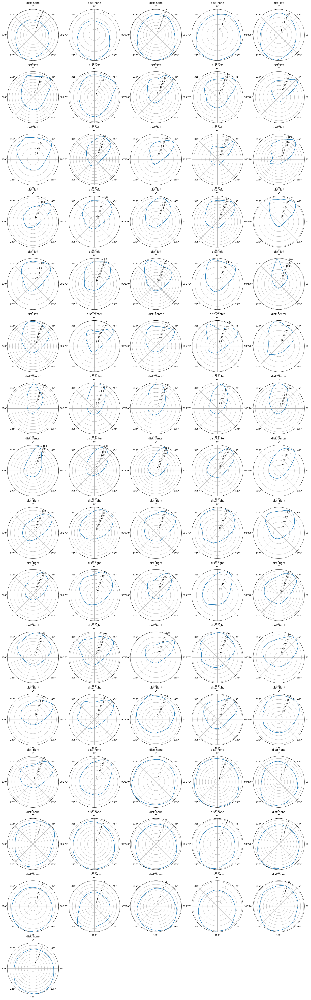

In [68]:
audio_file_name = "/home/nishimura-k/audioprocessing/datas/audio/150_ltor_data50/150_ltor_34_0.wav"
N = 512
interval = 12
fs = 16000
calculate_interval_sec(interval, fs, N)
audio = load_onefile(audio_file_name)
t_left_sec = 0
t_right_sec = audio.shape[1] / fs

P_MU_LIST, TIME_RANGE_LIST, beta = MUSIC_indexbase(audio_file_name, t_left_sec=t_left_sec, t_right_sec=t_right_sec, interval=interval, start_angle=-180, end_angle=175, N=N, weighting=False)

# print(np.allclose(P_MU_LIST[:, 0, :], P_MU_LIST[:, 40, :]))

csv_file_name = "/home/nishimura-k/audioprocessing/datas/csv/150_ltor_data50/150_ltor_34.csv"
distance_zero_csv = "/home/nishimura-k/audioprocessing/datas/csv/dicetance_thre/ltor_zero_point.csv"
left_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/dicetance_thre/150_ltor_left_thre.csv"
right_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/dicetance_thre/150_ltor_right_thre.csv"


AREA_LIST = calc_area_label(csv_file_name, distance_zero_csv, left_thre_csv, right_thre_csv, TIME_RANGE_LIST, mode="ltor")

# display_one_file_indexbase(P_MU_LIST, TIME_RANGE_LIST, AREA_LIST)
# print(AREA_LIST)

display_one_file_indexbase(P_MU_LIST, TIME_RANGE_LIST, AREA_LIST)

In [3]:
# ltor_200_firstからデータ生成
audio_dir = "/home/nishimura-k/audioprocessing/datas/audio/ltor_200_first"
csv_dir = "/home/nishimura-k/audioprocessing/datas/csv/ltor_200_first"
P_MU_LIST_dir = "/home/nishimura-k/audioprocessing/datas/npy_MUSIC/ltor_200_first"
AREA_LABEL_LIST_dir = "/home/nishimura-k/audioprocessing/datas/npy_AREA_label/ltor_200_first"
mode = "ltor"

if mode == "ltor":
  # ltor への処理
  distance_zero_csv = "/home/nishimura-k/audioprocessing/datas/csv/ltor_200_first/ltor_zero_point_200.csv"
  left_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/ltor_200_first/ltor_left_thre_200.csv"
  right_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/ltor_200_first/ltor_right_thre_200.csv"
elif mode == "rtol":
  distance_zero_csv = "/home/nishimura-k/audioprocessing/datas/csv/rtol_200_first/rtol_zero_point_200.csv"
  left_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/rtol_200_first/rtol_left_thre_200.csv"
  right_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/rtol_200_first/rtol_right_thre_200.csv"


for num in range(100):
  audio_file_name = audio_dir + "/ltor_200_" + str(num) + "_0.wav"
  csv_file_name = csv_dir + "/ltor_200_" + str(num) + ".csv"
  
  N = 512
  interval = 12
  fs = 16000
  calculate_interval_sec(interval, fs, N)
  audio = load_onefile(audio_file_name)
  t_left_sec = 0
  t_right_sec = audio.shape[1] / fs

  P_MU_LIST, TIME_RANGE_LIST = MUSIC_indexbase(audio_file_name, t_left_sec=t_left_sec, t_right_sec=t_right_sec, interval=interval, start_angle=-180, end_angle=180, N=N, weighting=False)
  AREA_LABEL_LIST = calc_area_label(csv_file_name, distance_zero_csv, left_thre_csv, right_thre_csv, TIME_RANGE_LIST, mode=mode)
  
  saved_file_name = f"/{mode}_200_" + str(num)
  P_MU_LIST_path = P_MU_LIST_dir + saved_file_name
  AREA_LABEL_LIST_path = AREA_LABEL_LIST_dir + saved_file_name

  np.save(P_MU_LIST_path, P_MU_LIST)
  np.save(AREA_LABEL_LIST_path, AREA_LABEL_LIST)
  print(f"No. {num} done.")

interval is 0.192 sec.
t_left_index: 0
t_right_index: 1064
No. 0 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 956
No. 1 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 802
No. 2 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 966
No. 3 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 879
No. 4 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 827
No. 5 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 1032
No. 6 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 939
No. 7 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 1039
No. 8 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 924
No. 9 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 979
No. 10 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 896
No. 11 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 905
No. 12 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 867
No. 13 done.
interval is 0

In [4]:
# ltor_200_firstからデータ生成
audio_dir = "/home/nishimura-k/audioprocessing/datas/audio/rtol_200_first"
csv_dir = "/home/nishimura-k/audioprocessing/datas/csv/rtol_200_first"
P_MU_LIST_dir = "/home/nishimura-k/audioprocessing/datas/npy_MUSIC/rtol_200_first"
AREA_LABEL_LIST_dir = "/home/nishimura-k/audioprocessing/datas/npy_AREA_label/rtol_200_first"
mode = "rtol"

if mode == "ltor":
  # ltor への処理
  distance_zero_csv = "/home/nishimura-k/audioprocessing/datas/csv/ltor_200_first/ltor_zero_point_200.csv"
  left_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/ltor_200_first/ltor_left_thre_200.csv"
  right_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/ltor_200_first/ltor_right_thre_200.csv"
elif mode == "rtol":
  # "rtol" への処理
  distance_zero_csv = "/home/nishimura-k/audioprocessing/datas/csv/rtol_200_first/rtol_zero_point_200.csv"
  left_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/rtol_200_first/rtol_left_thre_200.csv"
  right_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/rtol_200_first/rtol_right_thre_200.csv"


for num in range(100):
  audio_file_name = audio_dir + f"/{mode}_200_" + str(num) + "_0.wav"
  csv_file_name = csv_dir + f"/{mode}_200_" + str(num) + ".csv"
  
  N = 512
  interval = 12
  fs = 16000
  calculate_interval_sec(interval, fs, N)
  audio = load_onefile(audio_file_name)
  t_left_sec = 0
  t_right_sec = audio.shape[1] / fs

  P_MU_LIST, TIME_RANGE_LIST = MUSIC_indexbase(audio_file_name, t_left_sec=t_left_sec, t_right_sec=t_right_sec, interval=interval, start_angle=-180, end_angle=180, N=N, weighting=False)
  AREA_LABEL_LIST = calc_area_label(csv_file_name, distance_zero_csv, left_thre_csv, right_thre_csv, TIME_RANGE_LIST, mode="ltor")
  
  saved_file_name = f"/{mode}_200_" + str(num)
  P_MU_LIST_path = P_MU_LIST_dir + saved_file_name
  AREA_LABEL_LIST_path = AREA_LABEL_LIST_dir + saved_file_name

  np.save(P_MU_LIST_path, P_MU_LIST)
  np.save(AREA_LABEL_LIST_path, AREA_LABEL_LIST)
  print(f"No. {num} done.")

interval is 0.192 sec.
t_left_index: 0
t_right_index: 1008
No. 0 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 910
No. 1 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 971
No. 2 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 939
No. 3 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 33
No. 4 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 877
No. 5 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 887
No. 6 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 928
No. 7 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 859
No. 8 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 774
No. 9 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 846
No. 10 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 924
No. 11 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 939
No. 12 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 940
No. 13 done.
interval is 0.19

In [69]:
# 150_ltor_data50からデータ生成
audio_dir = "/home/nishimura-k/audioprocessing/datas/audio/150_ltor_data50"
csv_dir = "/home/nishimura-k/audioprocessing/datas/csv/150_ltor_data50"
P_MU_LIST_dir = "/home/nishimura-k/audioprocessing/datas/npy_MUSIC/150_ltor_data50"
AREA_LABEL_LIST_dir = "/home/nishimura-k/audioprocessing/datas/npy_AREA_label/150_ltor_data50"
mode = "ltor"

if mode == "ltor":
  # ltor への処理
  distance_zero_csv = "/home/nishimura-k/audioprocessing/datas/csv/dicetance_thre/ltor_zero_point.csv"
  left_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/dicetance_thre/150_ltor_left_thre.csv"
  right_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/dicetance_thre/150_ltor_right_thre.csv"
elif mode == "rtol":
  # "rtol" への処理
  distance_zero_csv = "/home/nishimura-k/audioprocessing/datas/csv/dicetance_thre/rtol_zero_point.csv"
  left_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/dicetance_thre/150_rtol_left_thre.csv"
  right_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/dicetance_thre/150_rtol_right_thre.csv"


for num in range(51):
  audio_file_name = audio_dir + f"/150_{mode}_" + str(num) + "_0.wav"
  csv_file_name = csv_dir + f"/150_{mode}_" + str(num) + ".csv"
  
  N = 512
  interval = 12
  fs = 16000
  calculate_interval_sec(interval, fs, N)
  audio = load_onefile(audio_file_name)
  t_left_sec = 0
  t_right_sec = audio.shape[1] / fs

  P_MU_LIST, TIME_RANGE_LIST, beta = MUSIC_indexbase(audio_file_name, t_left_sec=t_left_sec, t_right_sec=t_right_sec, interval=interval, start_angle=-180, end_angle=175, N=N, weighting=False)
  AREA_LABEL_LIST = calc_area_label(csv_file_name, distance_zero_csv, left_thre_csv, right_thre_csv, TIME_RANGE_LIST, mode=mode)
  
  saved_file_name = f"/150_{mode}_" + str(num)
  P_MU_LIST_path = P_MU_LIST_dir + saved_file_name
  AREA_LABEL_LIST_path = AREA_LABEL_LIST_dir + saved_file_name

  np.save(P_MU_LIST_path, P_MU_LIST)
  np.save(AREA_LABEL_LIST_path, AREA_LABEL_LIST)
  print(f"No. {num} done.")

interval is 0.192 sec.
t_left_index: 0
t_right_index: 857
No. 0 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 924
No. 1 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 752
No. 2 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 753
No. 3 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 768
No. 4 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 764
No. 5 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 739
No. 6 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 782
No. 7 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 737
No. 8 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 709
No. 9 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 732
No. 10 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 765
No. 11 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 784
No. 12 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 977
No. 13 done.
interval is 0.19

In [70]:
# 150_rtol_data50からデータ生成
audio_dir = "/home/nishimura-k/audioprocessing/datas/audio/150_rtol_data50"
csv_dir = "/home/nishimura-k/audioprocessing/datas/csv/150_rtol_data50"
P_MU_LIST_dir = "/home/nishimura-k/audioprocessing/datas/npy_MUSIC/150_rtol_data50"
AREA_LABEL_LIST_dir = "/home/nishimura-k/audioprocessing/datas/npy_AREA_label/150_rtol_data50"
mode = "rtol"

if mode == "ltor":
  # ltor への処理
  distance_zero_csv = "/home/nishimura-k/audioprocessing/datas/csv/dicetance_thre/ltor_zero_point.csv"
  left_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/dicetance_thre/150_ltor_left_thre.csv"
  right_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/dicetance_thre/150_ltor_right_thre.csv"
elif mode == "rtol":
  # "rtol" への処理
  distance_zero_csv = "/home/nishimura-k/audioprocessing/datas/csv/dicetance_thre/rtol_zero_point.csv"
  left_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/dicetance_thre/150_rtol_left_thre.csv"
  right_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/dicetance_thre/150_rtol_right_thre.csv"


for num in range(51):
  audio_file_name = audio_dir + f"/150_{mode}_" + str(num) + "_0.wav"
  csv_file_name = csv_dir + f"/150_{mode}_" + str(num) + ".csv"
  
  N = 512
  interval = 12
  fs = 16000
  calculate_interval_sec(interval, fs, N)
  audio = load_onefile(audio_file_name)
  t_left_sec = 0
  t_right_sec = audio.shape[1] / fs

  P_MU_LIST, TIME_RANGE_LIST, beta = MUSIC_indexbase(audio_file_name, t_left_sec=t_left_sec, t_right_sec=t_right_sec, interval=interval, start_angle=-180, end_angle=175, N=N, weighting=False)
  AREA_LABEL_LIST = calc_area_label(csv_file_name, distance_zero_csv, left_thre_csv, right_thre_csv, TIME_RANGE_LIST, mode=mode)
  
  saved_file_name = f"/150_{mode}_" + str(num)
  P_MU_LIST_path = P_MU_LIST_dir + saved_file_name
  AREA_LABEL_LIST_path = AREA_LABEL_LIST_dir + saved_file_name

  np.save(P_MU_LIST_path, P_MU_LIST)
  np.save(AREA_LABEL_LIST_path, AREA_LABEL_LIST)
  print(f"No. {num} done.")

interval is 0.192 sec.
t_left_index: 0
t_right_index: 930
No. 0 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 833
No. 1 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 768
No. 2 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 909
No. 3 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 858
No. 4 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 891
No. 5 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 882
No. 6 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 852
No. 7 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 799
No. 8 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 846
No. 9 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 784
No. 10 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 802
No. 11 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 798
No. 12 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 893
No. 13 done.
interval is 0.19

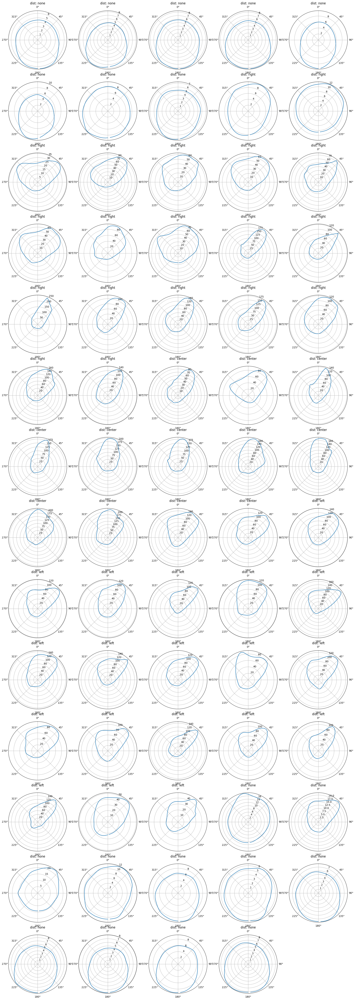

In [72]:
P_MU_LIST = np.load("/home/nishimura-k/audioprocessing/datas/npy_MUSIC/150_rtol_data50/150_rtol_50.npy")
AREA_LABEL_LIST = np.load("/home/nishimura-k/audioprocessing/datas/npy_AREA_label/150_rtol_data50/150_rtol_50.npy", allow_pickle=True)
display_one_file_indexbase(P_MU_LIST, None, AREA_LABEL_LIST)

In [63]:
# アレイマニフォールドベクトルaの0と73がほぼ同じ値か調査

n_mic = 8
n_src = 3
window = "hann"
c = 340
freq_l = 100
freq_h = 4000

start_angle = -180
end_angle = 180

fs = 16000
k_l = int(freq_l / (fs / N))
k_h = int(freq_h / (fs / N))

file_name = "/home/nishimura-k/audioprocessing/datas/audio/150_ltor_data50/150_ltor_0_0.wav"

audio = load_onefile(file_name)

noverlap = N / 2 

# X: マイク数 x 周波数インデックス x 時間インデックス
f, t, X = sg.stft(audio, fs, window=window, nperseg=N, noverlap=noverlap)
n_bin = X.shape[1]

t_left_index = (int)(t_left_sec // ((N - noverlap)/fs))
t_right_index = (int)((t_right_sec + ((N - noverlap) / fs)) // ((N - noverlap) / fs))
print(f"t_left_index: {t_left_index}")
print(f"t_right_index: {t_right_index}")

theta = np.linspace(
    start_angle, end_angle, num=((end_angle - start_angle) // 5) + 1
)
P_MU_LIST = None
TIME_RANGE_LIST = None

a = calc_array_manifold_vector(theta, n_mic, n_bin, fs, N, c)

print(a.shape)

for i in range(73):
  print(f"{i}:{np.allclose(a[0], a[i])}")

t_left_index: 0
t_right_index: 924
(73, 8, 1, 257)
0:True
1:False
2:False
3:False
4:False
5:False
6:False
7:False
8:False
9:False
10:False
11:False
12:False
13:False
14:False
15:False
16:False
17:False
18:False
19:False
20:False
21:False
22:False
23:False
24:False
25:False
26:False
27:False
28:False
29:False
30:False
31:False
32:False
33:False
34:False
35:False
36:False
37:False
38:False
39:False
40:False
41:False
42:False
43:False
44:False
45:False
46:False
47:False
48:False
49:False
50:False
51:False
52:False
53:False
54:False
55:False
56:False
57:False
58:False
59:False
60:False
61:False
62:False
63:False
64:False
65:False
66:False
67:False
68:False
69:False
70:False
71:False
72:True


interval is 0.192 sec.
t_left_index: 0
t_right_index: 814


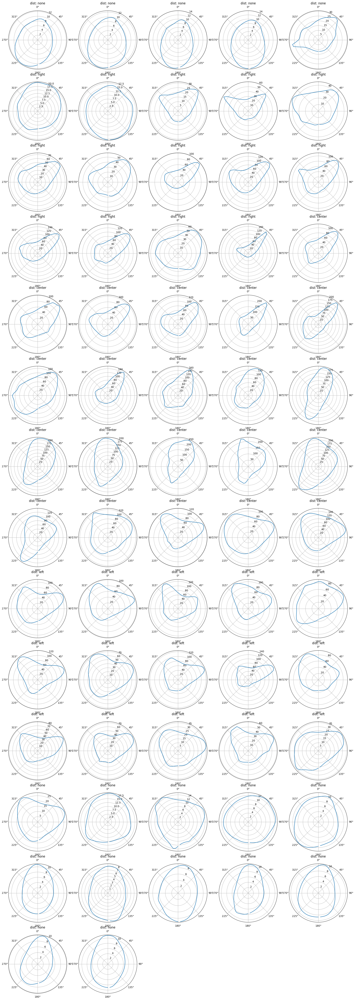

In [16]:
# E-F棟のデータをテスト
audio_file_name = "/home/nishimura-k/audioprocessing/datas/audio/EF/EF_rtol_test_150/EF_rtol_test_150_2_0.wav"
N = 512
interval = 12
fs = 16000
calculate_interval_sec(interval, fs, N)
audio = load_onefile(audio_file_name)
t_left_sec = 0
t_right_sec = audio.shape[1] / fs

P_MU_LIST, TIME_RANGE_LIST, beta = MUSIC_indexbase(audio_file_name, t_left_sec=t_left_sec, t_right_sec=t_right_sec, interval=interval, start_angle=-180, end_angle=175, N=N, weighting=False)

# print(np.allclose(P_MU_LIST[:, 0, :], P_MU_LIST[:, 40, :]))

csv_file_name = "/home/nishimura-k/audioprocessing/datas/csv/EF/EF_rtol_test_150/EF_rtol_test_150_2.csv"
distance_zero_csv = "/home/nishimura-k/audioprocessing/datas/csv/EF/EF_rtol_test_150/EF_rtol_zero_point.csv"
left_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/EF/EF_rtol_test_150/EF_rtol_left_thre_150.csv"
right_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/EF/EF_rtol_test_150/EF_rtol_right_thre_150.csv"


AREA_LIST = calc_area_label(csv_file_name, distance_zero_csv, left_thre_csv, right_thre_csv, TIME_RANGE_LIST, mode="rtol")

# display_one_file_indexbase(P_MU_LIST, TIME_RANGE_LIST, AREA_LIST)
# print(AREA_LIST)

display_one_file_indexbase(P_MU_LIST, TIME_RANGE_LIST, AREA_LIST)


In [18]:
# EF_ltor_150_0to59からデータ生成
audio_dir = "/home/nishimura-k/audioprocessing/datas/audio/EF/EF_ltor_150_0to59"
csv_dir = "/home/nishimura-k/audioprocessing/datas/csv/EF/EF_ltor_150_0to59"
P_MU_LIST_dir = "/home/nishimura-k/audioprocessing/datas/npy_MUSIC/EF/EF_ltor_150_0to59"
AREA_LABEL_LIST_dir = "/home/nishimura-k/audioprocessing/datas/npy_AREA_label/EF/EF_ltor_150_0to59"

mode = "ltor"

if mode == "ltor":
  # ltor への処理
  distance_zero_csv = "/home/nishimura-k/audioprocessing/datas/csv/EF/disctance_thre/EF_ltor_zero_point.csv"
  left_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/EF/disctance_thre/EF_ltor_left_thre_150.csv"
  right_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/EF/disctance_thre/EF_ltor_right_thre_150.csv"
elif mode == "rtol":
  # "rtol" への処理
  distance_zero_csv = "/home/nishimura-k/audioprocessing/datas/csv/EF/disctance_thre/EF_rtol_zero_point.csv"
  left_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/EF/disctance_thre/EF_rtol_left_thre_150.csv"
  right_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/EF/disctance_thre/EF_rtol_right_thre_150.csv"


for num in range(60):
  audio_file_name = audio_dir + f"/EF_{mode}_150_" + str(num) + "_0.wav"
  csv_file_name = csv_dir + f"/EF_{mode}_150_" + str(num) + ".csv"
  
  N = 512
  interval = 12
  fs = 16000
  calculate_interval_sec(interval, fs, N)
  audio = load_onefile(audio_file_name)
  t_left_sec = 0
  t_right_sec = audio.shape[1] / fs

  P_MU_LIST, TIME_RANGE_LIST, beta = MUSIC_indexbase(audio_file_name, t_left_sec=t_left_sec, t_right_sec=t_right_sec, interval=interval, start_angle=-180, end_angle=175, N=N, weighting=False)
  AREA_LABEL_LIST = calc_area_label(csv_file_name, distance_zero_csv, left_thre_csv, right_thre_csv, TIME_RANGE_LIST, mode=mode)
  
  saved_file_name = f"/EF_{mode}_150_" + str(num)
  P_MU_LIST_path = P_MU_LIST_dir + saved_file_name
  AREA_LABEL_LIST_path = AREA_LABEL_LIST_dir + saved_file_name

  np.save(P_MU_LIST_path, P_MU_LIST)
  np.save(AREA_LABEL_LIST_path, AREA_LABEL_LIST)
  print(f"No. {num} done.")

interval is 0.192 sec.
t_left_index: 0
t_right_index: 862
No. 0 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 822
No. 1 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 828
No. 2 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 768
No. 3 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 733
No. 4 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 814
No. 5 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 866
No. 6 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 799
No. 7 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 877
No. 8 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 830
No. 9 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 891
No. 10 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 955
No. 11 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 877
No. 12 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 830
No. 13 done.
interval is 0.19

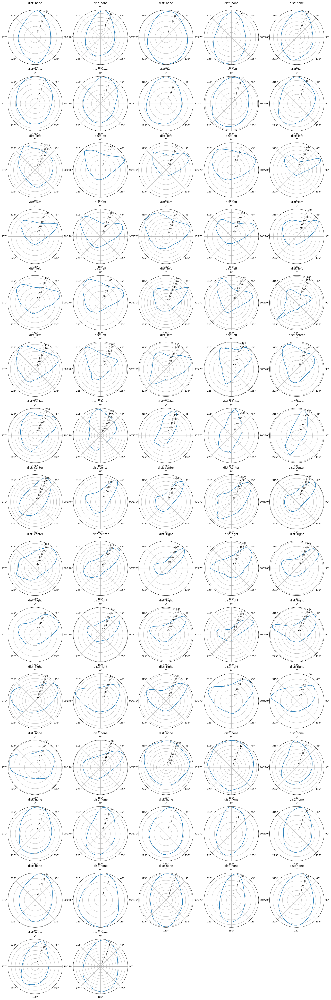

In [19]:
# EF_ltor_150_0to59からデータ生成できたか確認
P_MU_LIST = np.load("/home/nishimura-k/audioprocessing/datas/npy_MUSIC/EF/EF_ltor_150_0to59/EF_ltor_150_14.npy")
AREA_LABEL_LIST = np.load("/home/nishimura-k/audioprocessing/datas/npy_AREA_label/EF/EF_ltor_150_0to59/EF_ltor_150_14.npy", allow_pickle=True)
display_one_file_indexbase(P_MU_LIST, None, AREA_LABEL_LIST)

In [20]:
# EF_rtol_150_0to59からデータ生成
place = "EF"
mode = "rtol"
data_from = 0
data_to = 59
mic_distance = 150

audio_dir = f"/home/nishimura-k/audioprocessing/datas/audio/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"
csv_dir = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"
P_MU_LIST_dir = f"/home/nishimura-k/audioprocessing/datas/npy_MUSIC/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"
AREA_LABEL_LIST_dir = f"/home/nishimura-k/audioprocessing/datas/npy_AREA_label/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"


if mode == "ltor":
  # ltor への処理
  distance_zero_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_ltor_zero_point.csv"
  left_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_ltor_left_thre_{mic_distance}.csv"
  right_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_ltor_right_thre_{mic_distance}.csv"
elif mode == "rtol":
  # "rtol" への処理
  distance_zero_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_rtol_zero_point.csv"
  left_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_rtol_left_thre_{mic_distance}.csv"
  right_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_rtol_right_thre_{mic_distance}.csv"


for num in range(60):
  audio_file_name = audio_dir + f"/{place}_{mode}_{mic_distance}_" + str(num) + "_0.wav"
  csv_file_name = csv_dir + f"/{place}_{mode}_{mic_distance}_" + str(num) + ".csv"
  
  N = 512
  interval = 12
  fs = 16000
  calculate_interval_sec(interval, fs, N)
  audio = load_onefile(audio_file_name)
  t_left_sec = 0
  t_right_sec = audio.shape[1] / fs

  P_MU_LIST, TIME_RANGE_LIST, beta = MUSIC_indexbase(audio_file_name, t_left_sec=t_left_sec, t_right_sec=t_right_sec, interval=interval, start_angle=-180, end_angle=175, N=N, weighting=False)
  AREA_LABEL_LIST = calc_area_label(csv_file_name, distance_zero_csv, left_thre_csv, right_thre_csv, TIME_RANGE_LIST, mode=mode)
  
  saved_file_name = f"/EF_{mode}_150_" + str(num)
  P_MU_LIST_path = P_MU_LIST_dir + saved_file_name
  AREA_LABEL_LIST_path = AREA_LABEL_LIST_dir + saved_file_name

  np.save(P_MU_LIST_path, P_MU_LIST)
  np.save(AREA_LABEL_LIST_path, AREA_LABEL_LIST)
  print(f"No. {num} done.")

interval is 0.192 sec.
t_left_index: 0
t_right_index: 960
No. 0 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 877
No. 1 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 857
No. 2 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 830
No. 3 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 799
No. 4 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 799
No. 5 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 939
No. 6 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 821
No. 7 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 896
No. 8 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 799
No. 9 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 852
No. 10 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 880
No. 11 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 924
No. 12 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 896
No. 13 done.
interval is 0.19

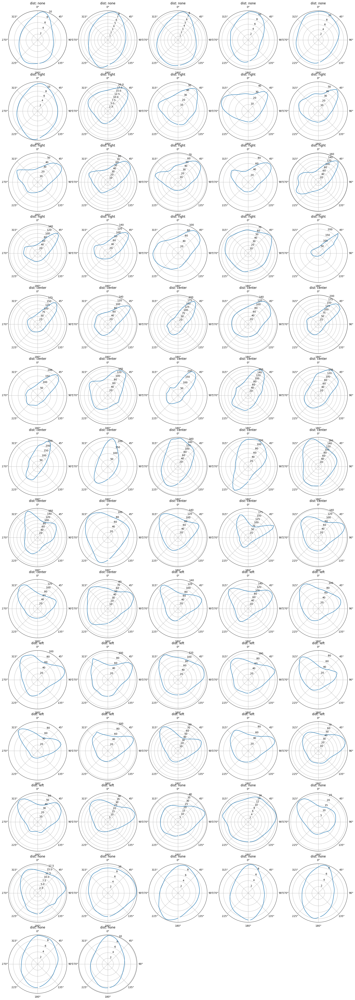

In [21]:
# EF_ltor_150_0to59からデータ生成できたか確認
P_MU_LIST = np.load("/home/nishimura-k/audioprocessing/datas/npy_MUSIC/EF/EF_rtol_150_0to59/EF_rtol_150_59.npy")
AREA_LABEL_LIST = np.load("/home/nishimura-k/audioprocessing/datas/npy_AREA_label/EF/EF_rtol_150_0to59/EF_rtol_150_59.npy", allow_pickle=True)
display_one_file_indexbase(P_MU_LIST, None, AREA_LABEL_LIST)

interval is 0.192 sec.
t_left_index: 0
t_right_index: 815


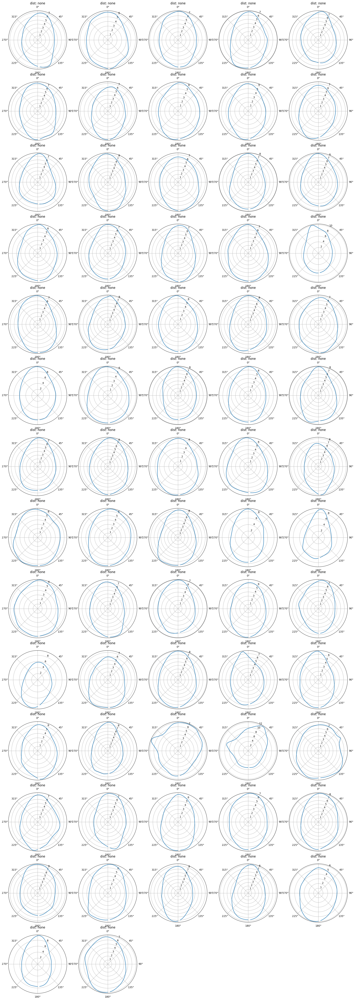

In [30]:
# E-F棟60to109データをテスト
audio_file_name = "/home/nishimura-k/audioprocessing/datas/audio/EF/EF_none_150_0to49/EF_none_150_45_0.wav"
N = 512
interval = 12
fs = 16000
calculate_interval_sec(interval, fs, N)
audio = load_onefile(audio_file_name)
t_left_sec = 0
t_right_sec = audio.shape[1] / fs

P_MU_LIST, TIME_RANGE_LIST, beta = MUSIC_indexbase(audio_file_name, t_left_sec=t_left_sec, t_right_sec=t_right_sec, interval=interval, start_angle=-180, end_angle=175, N=N, weighting=False)

# print(np.allclose(P_MU_LIST[:, 0, :], P_MU_LIST[:, 40, :]))

csv_file_name = "/home/nishimura-k/audioprocessing/datas/csv/EF/EF_none_150_0to49/EF_none_150_45.csv"
distance_zero_csv = "/home/nishimura-k/audioprocessing/datas/csv/EF/disctance_thre/EF_rtol_zero_point.csv"
left_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/EF/disctance_thre/EF_rtol_left_thre_150.csv"
right_thre_csv = "/home/nishimura-k/audioprocessing/datas/csv/EF/disctance_thre/EF_rtol_right_thre_150.csv"


AREA_LIST = calc_area_label(csv_file_name, distance_zero_csv, left_thre_csv, right_thre_csv, TIME_RANGE_LIST, mode="rtol")

# display_one_file_indexbase(P_MU_LIST, TIME_RANGE_LIST, AREA_LIST)
# print(AREA_LIST)

display_one_file_indexbase(P_MU_LIST, TIME_RANGE_LIST, AREA_LIST)

In [28]:
# EF_ltor_150_60to109からデータ生成
place = "EF"
mode = "ltor"
data_from = 60
data_to = 109
mic_distance = 150

audio_dir = f"/home/nishimura-k/audioprocessing/datas/audio/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"
csv_dir = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"
P_MU_LIST_dir = f"/home/nishimura-k/audioprocessing/datas/npy_MUSIC/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"
AREA_LABEL_LIST_dir = f"/home/nishimura-k/audioprocessing/datas/npy_AREA_label/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"


if mode == "ltor":
  # ltor への処理
  distance_zero_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_ltor_zero_point.csv"
  left_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_ltor_left_thre_{mic_distance}.csv"
  right_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_ltor_right_thre_{mic_distance}.csv"
elif mode == "rtol":
  # "rtol" への処理
  distance_zero_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_rtol_zero_point.csv"
  left_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_rtol_left_thre_{mic_distance}.csv"
  right_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_rtol_right_thre_{mic_distance}.csv"


for num in range(data_to - data_from + 1):
  data_num = data_from + num
  audio_file_name = audio_dir + f"/{place}_{mode}_{mic_distance}_" + str(data_num) + "_0.wav"
  csv_file_name = csv_dir + f"/{place}_{mode}_{mic_distance}_" + str(data_num) + ".csv"
  
  N = 512
  interval = 12
  fs = 16000
  calculate_interval_sec(interval, fs, N)
  audio = load_onefile(audio_file_name)
  t_left_sec = 0
  t_right_sec = audio.shape[1] / fs

  P_MU_LIST, TIME_RANGE_LIST, beta = MUSIC_indexbase(audio_file_name, t_left_sec=t_left_sec, t_right_sec=t_right_sec, interval=interval, start_angle=-180, end_angle=175, N=N, weighting=False)
  AREA_LABEL_LIST = calc_area_label(csv_file_name, distance_zero_csv, left_thre_csv, right_thre_csv, TIME_RANGE_LIST, mode=mode)
  
  saved_file_name = f"/EF_{mode}_150_" + str(data_num)
  P_MU_LIST_path = P_MU_LIST_dir + saved_file_name
  AREA_LABEL_LIST_path = AREA_LABEL_LIST_dir + saved_file_name

  np.save(P_MU_LIST_path, P_MU_LIST)
  np.save(AREA_LABEL_LIST_path, AREA_LABEL_LIST)
  print(f"No. {data_num} done.")

interval is 0.192 sec.
t_left_index: 0
t_right_index: 955
No. 60 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 891
No. 61 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 955
No. 62 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 897
No. 63 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 805
No. 64 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 830
No. 65 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 814
No. 66 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 877
No. 67 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 846
No. 68 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 846
No. 69 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 913
No. 70 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 846
No. 71 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 914
No. 72 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 814
No. 73 done.
interv

In [29]:
# EF_rtol_150_60to109からデータ生成
place = "EF"
mode = "rtol"
data_from = 60
data_to = 109
mic_distance = 150

audio_dir = f"/home/nishimura-k/audioprocessing/datas/audio/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"
csv_dir = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"
P_MU_LIST_dir = f"/home/nishimura-k/audioprocessing/datas/npy_MUSIC/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"
AREA_LABEL_LIST_dir = f"/home/nishimura-k/audioprocessing/datas/npy_AREA_label/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"


if mode == "ltor":
  # ltor への処理
  distance_zero_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_ltor_zero_point.csv"
  left_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_ltor_left_thre_{mic_distance}.csv"
  right_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_ltor_right_thre_{mic_distance}.csv"
elif mode == "rtol":
  # "rtol" への処理
  distance_zero_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_rtol_zero_point.csv"
  left_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_rtol_left_thre_{mic_distance}.csv"
  right_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_rtol_right_thre_{mic_distance}.csv"


for num in range(data_to - data_from + 1):
  data_num = data_from + num
  audio_file_name = audio_dir + f"/{place}_{mode}_{mic_distance}_" + str(data_num) + "_0.wav"
  csv_file_name = csv_dir + f"/{place}_{mode}_{mic_distance}_" + str(data_num) + ".csv"
  
  N = 512
  interval = 12
  fs = 16000
  calculate_interval_sec(interval, fs, N)
  audio = load_onefile(audio_file_name)
  t_left_sec = 0
  t_right_sec = audio.shape[1] / fs

  P_MU_LIST, TIME_RANGE_LIST, beta = MUSIC_indexbase(audio_file_name, t_left_sec=t_left_sec, t_right_sec=t_right_sec, interval=interval, start_angle=-180, end_angle=175, N=N, weighting=False)
  AREA_LABEL_LIST = calc_area_label(csv_file_name, distance_zero_csv, left_thre_csv, right_thre_csv, TIME_RANGE_LIST, mode=mode)
  
  saved_file_name = f"/EF_{mode}_150_" + str(data_num)
  P_MU_LIST_path = P_MU_LIST_dir + saved_file_name
  AREA_LABEL_LIST_path = AREA_LABEL_LIST_dir + saved_file_name

  np.save(P_MU_LIST_path, P_MU_LIST)
  np.save(AREA_LABEL_LIST_path, AREA_LABEL_LIST)
  print(f"No. {data_num} done.")

interval is 0.192 sec.
t_left_index: 0
t_right_index: 993
No. 60 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 876
No. 61 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 773
No. 62 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 846
No. 63 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 877
No. 64 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 892
No. 65 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 908
No. 66 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 830
No. 67 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 801
No. 68 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 798
No. 69 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 765
No. 70 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 783
No. 71 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 804
No. 72 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 942
No. 73 done.
interv

In [32]:
# EF_rtol_150_60to109からデータ生成
place = "EF"
mode = "none"
data_from = 0
data_to = 49
mic_distance = 150

audio_dir = f"/home/nishimura-k/audioprocessing/datas/audio/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"
csv_dir = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"
P_MU_LIST_dir = f"/home/nishimura-k/audioprocessing/datas/npy_MUSIC/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"
AREA_LABEL_LIST_dir = f"/home/nishimura-k/audioprocessing/datas/npy_AREA_label/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"


if mode == "ltor":
  # ltor への処理
  distance_zero_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_ltor_zero_point.csv"
  left_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_ltor_left_thre_{mic_distance}.csv"
  right_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_ltor_right_thre_{mic_distance}.csv"
elif mode == "rtol":
  # "rtol" への処理
  distance_zero_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_rtol_zero_point.csv"
  left_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_rtol_left_thre_{mic_distance}.csv"
  right_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_rtol_right_thre_{mic_distance}.csv"

elif mode == "none":
  # "none" への処理
  distance_zero_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_rtol_zero_point.csv"
  left_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_rtol_left_thre_{mic_distance}.csv"
  right_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/{place}/disctance_thre/{place}_rtol_right_thre_{mic_distance}.csv"



for num in range(data_to - data_from + 1):
  data_num = data_from + num
  audio_file_name = audio_dir + f"/{place}_{mode}_{mic_distance}_" + str(data_num) + "_0.wav"
  csv_file_name = csv_dir + f"/{place}_{mode}_{mic_distance}_" + str(data_num) + ".csv"
  
  N = 512
  interval = 12
  fs = 16000
  calculate_interval_sec(interval, fs, N)
  audio = load_onefile(audio_file_name)
  t_left_sec = 0
  t_right_sec = audio.shape[1] / fs

  P_MU_LIST, TIME_RANGE_LIST, beta = MUSIC_indexbase(audio_file_name, t_left_sec=t_left_sec, t_right_sec=t_right_sec, interval=interval, start_angle=-180, end_angle=175, N=N, weighting=False)
  AREA_LABEL_LIST = calc_area_label(csv_file_name, distance_zero_csv, left_thre_csv, right_thre_csv, TIME_RANGE_LIST, mode=mode)
  
  saved_file_name = f"/EF_{mode}_150_" + str(data_num)
  P_MU_LIST_path = P_MU_LIST_dir + saved_file_name
  AREA_LABEL_LIST_path = AREA_LABEL_LIST_dir + saved_file_name

  np.save(P_MU_LIST_path, P_MU_LIST)
  np.save(AREA_LABEL_LIST_path, AREA_LABEL_LIST)
  print(f"No. {data_num} done.")

interval is 0.192 sec.
t_left_index: 0
t_right_index: 783
No. 0 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 846
No. 1 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 841
No. 2 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 1021
No. 3 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 884
No. 4 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 817
No. 5 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 913
No. 6 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 830
No. 7 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 1189
No. 8 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 955
No. 9 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 987
No. 10 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 986
No. 11 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 836
No. 12 done.
interval is 0.192 sec.
t_left_index: 0
t_right_index: 1010
No. 13 done.
interval is 0

In [ ]:
# EF_rtol_150_60to109からデータ生成
place = "EF"
mode = "rtol"
data_from = 0
data_to = 50
mic_distance = 150

audio_dir = f"/home/nishimura-k/audioprocessing/datas/audio/150_ltor_data50"
csv_dir = f"/home/nishimura-k/audioprocessing/datas/csv/nourin/150_ltor_data50"
P_MU_LIST_dir = f"/home/nishimura-k/audioprocessing/datas/npy_MUSIC/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"
AREA_LABEL_LIST_dir = f"/home/nishimura-k/audioprocessing/datas/npy_AREA_label/{place}/{place}_{mode}_{mic_distance}_{data_from}to{data_to}"


if mode == "ltor":
  # ltor への処理
  distance_zero_csv = f"/home/nishimura-k/audioprocessing/datas/csv/nourin/dicetance_thre/ltor_zero_point.csv"
  left_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/nourin/dicetance_thre/150_ltor_left_thre.csv"
  right_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/nourin/dicetance_thre/150_ltor_right_thre.csv"
elif mode == "rtol":
  # "rtol" への処理
  distance_zero_csv = f"/home/nishimura-k/audioprocessing/datas/csv/nourin/dicetance_thre/rtol_zero_point.csv"
  left_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/nourin/dicetance_thre/150_rtol_left_thre.csv"
  right_thre_csv = f"/home/nishimura-k/audioprocessing/datas/csv/nourin/dicetance_thre/150_rtol_right_thre.csv"


for num in range(data_to - data_from + 1):
  data_num = data_from + num
  audio_file_name = audio_dir + f"/{place}_{mode}_{mic_distance}_" + str(data_num) + "_0.wav"
  csv_file_name = csv_dir + f"/{place}_{mode}_{mic_distance}_" + str(data_num) + ".csv"
  
  N = 512
  interval = 12
  fs = 16000
  calculate_interval_sec(interval, fs, N)
  audio = load_onefile(audio_file_name)
  t_left_sec = 0
  t_right_sec = audio.shape[1] / fs

  P_MU_LIST, TIME_RANGE_LIST, beta = MUSIC_indexbase(audio_file_name, t_left_sec=t_left_sec, t_right_sec=t_right_sec, interval=interval, start_angle=-180, end_angle=175, N=N, weighting=False)
  AREA_LABEL_LIST = calc_area_label(csv_file_name, distance_zero_csv, left_thre_csv, right_thre_csv, TIME_RANGE_LIST, mode=mode)
  
  saved_file_name = f"/{place}_{mode}_150_" + str(data_num)
  P_MU_LIST_path = P_MU_LIST_dir + saved_file_name
  AREA_LABEL_LIST_path = AREA_LABEL_LIST_dir + saved_file_name

  np.save(P_MU_LIST_path, P_MU_LIST)
  np.save(AREA_LABEL_LIST_path, AREA_LABEL_LIST)
  print(f"No. {data_num} done.")